# Refine tangram annotations using clustering for heart_s0

In [1]:
slide_id = "heart_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")
sdata

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_77083/4156079343.py:1: DeprecationWarning: Table group found in zarr store at location /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_heart_s0.zarr. Please update the zarr storeto use tables instead.
  sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")


SpatialData object with:
├── Images
│     └── 'he': MultiscaleSpatialImage[cyx] (3, 10645, 24544), (3, 5323, 12272)
├── Points
│     └── 'st': DataFrame with shape: (2452409, 10) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (26366, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (26366, 541)
with coordinate systems:
▸ '_st_intrinsic', with elements:
        st (Points)
▸ 'global', with elements:
        he (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_77083/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 26366 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,12.417846,B cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,8.918372,Plasma cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,9.776227,Plasma cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,35.131678,Endocardial cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,38.134416,Neuron
...,...,...,...,...,...
aaaaggpj-1,nucleus_boundaries,morpho,aaaaggpj-1,42.628748,NK cell
aaaaggpk-1,nucleus_boundaries,morpho,aaaaggpk-1,65.838842,Ventricular cardiomyocyte
aaaaggpl-1,nucleus_boundaries,morpho,aaaaggpl-1,32.083378,PCOLCE2 fibroblast
aaaaggpm-1,nucleus_boundaries,morpho,aaaaggpm-1,25.151819,Arterial EC


In [6]:
adata_ini.var

""
ABCC11
ACE2
ACKR1
ACTA2
ACTG2
...
UnassignedCodeword_0499
VCAN
VSIG4
VWA5A


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,12.417846,B cell,5
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,8.918372,Plasma cell,6
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,9.776227,Plasma cell,5
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,35.131678,Endocardial cell,22
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,38.134416,Neuron,20
...,...,...,...,...,...,...
aaaaggpj-1,nucleus_boundaries,morpho,aaaaggpj-1,42.628748,NK cell,24
aaaaggpk-1,nucleus_boundaries,morpho,aaaaggpk-1,65.838842,Ventricular cardiomyocyte,49
aaaaggpl-1,nucleus_boundaries,morpho,aaaaggpl-1,32.083378,PCOLCE2 fibroblast,10
aaaaggpm-1,nucleus_boundaries,morpho,aaaaggpm-1,25.151819,Arterial EC,25


<Axes: >

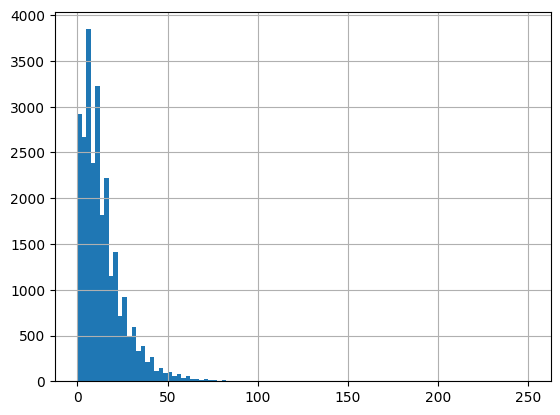

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

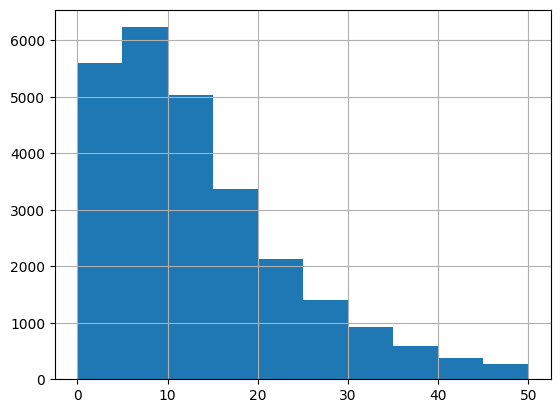

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 20220
Percentage of cells with less than 20 transcripts: 76.69%
-----
Number of cells with less than 15 transcripts: 16853
Percentage of cells with less than 15 transcripts: 63.92%
-----
Number of cells with less than 10 transcripts: 11820
Percentage of cells with less than 10 transcripts: 44.83%
-----
Number total of cells: 26366


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

13411


In [12]:
# Save the raw data
adata.layers['count'] = adata.X.copy()

In [13]:
# Normalize
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()

In [14]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [15]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


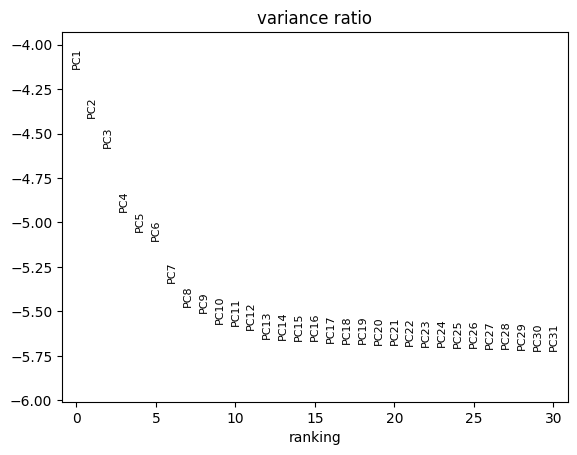

In [16]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata, log=True)

In [17]:
adata

AnnData object with n_obs × n_vars = 13411 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts'
    var: 'mean', 'std'
    uns: 'sopa_attrs', 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'tangram_pred', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [18]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [19]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_77083/2486232371.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


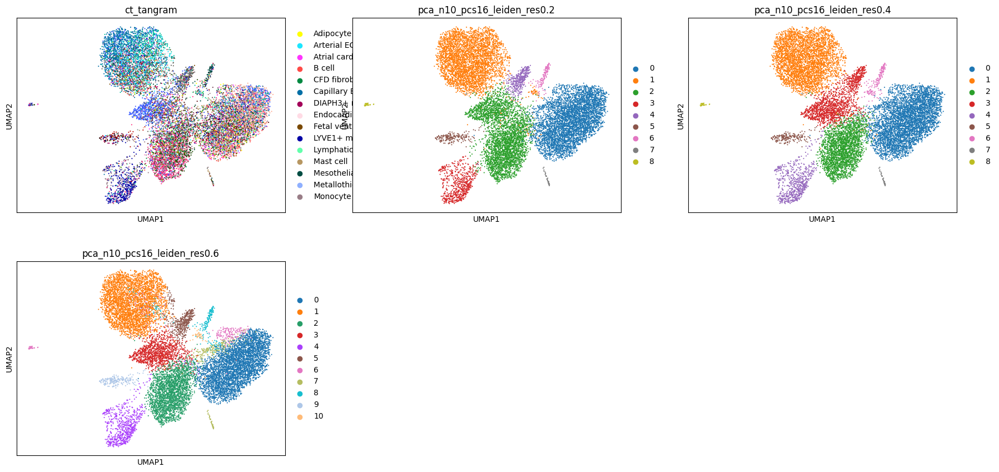

In [20]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3)

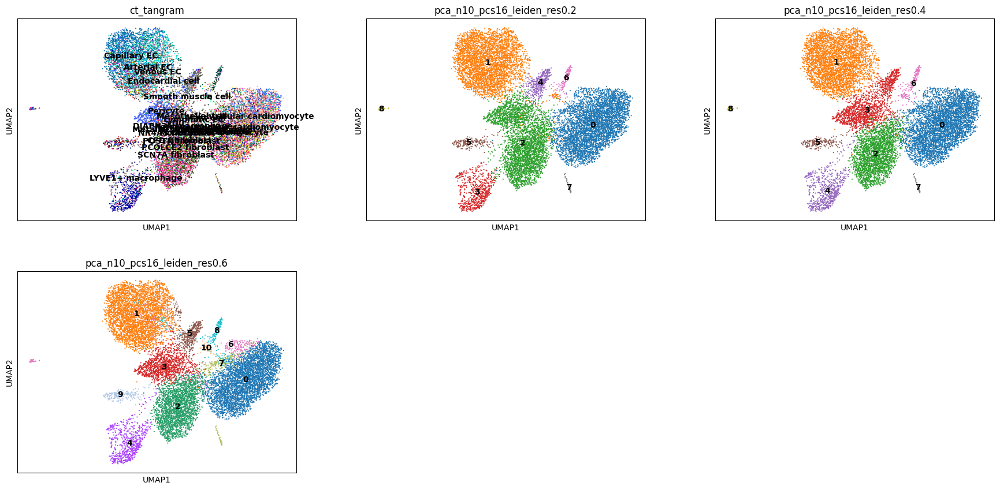

In [21]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

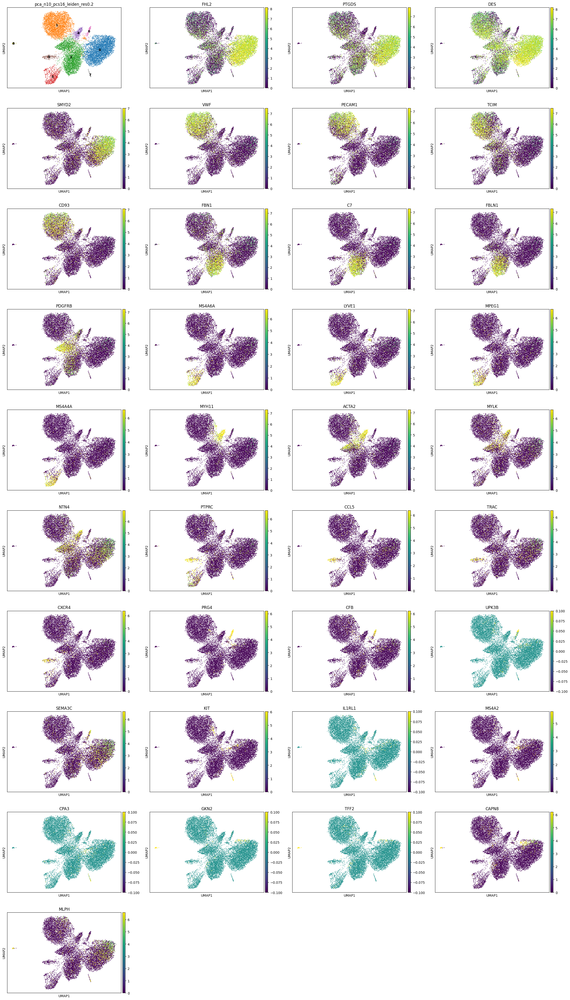

In [22]:
clustering_label = 'pca_n10_pcs16_leiden_res0.2'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

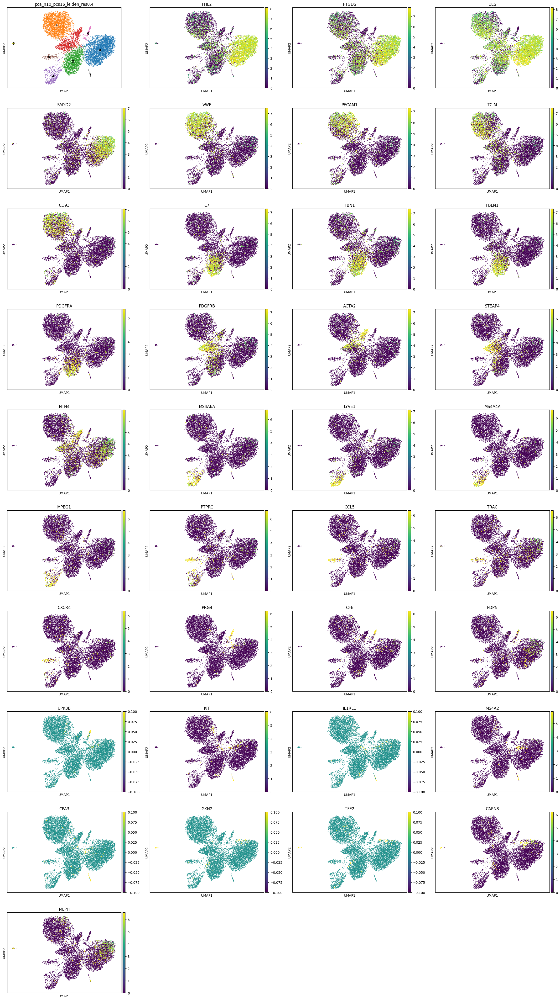

In [23]:
clustering_label = 'pca_n10_pcs16_leiden_res0.4'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [24]:
# Number of clusters
adata.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['0', '1', '5', '2', '4', '3', '6', '7', '8']
Categories (9, object): ['0', '1', '2', '3', ..., '5', '6', '7', '8']

In [25]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['4']), 'refine_res'] = '9'

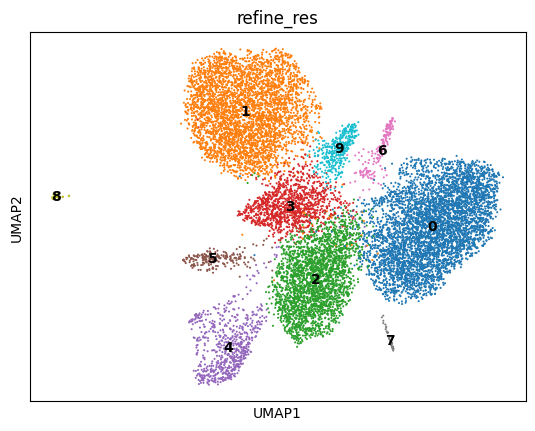

In [26]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [27]:
clustering_label = 'refine_res'

In [28]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_77083/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


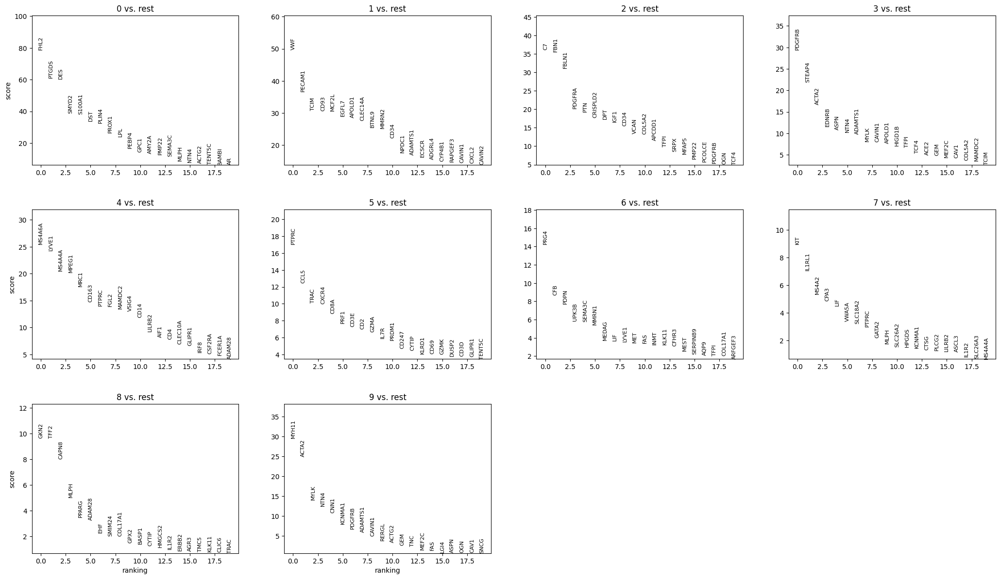

In [29]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [30]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:5, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [31]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [32]:
cluster_id = '0'

In [33]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,Ventricular cardiomyocyte,21
1,0,Pericyte,9
2,0,Monocyte,6
3,0,Neuron,5
4,0,Venous EC,5
5,0,B cell,5
6,0,SCN7A fibroblast,4


In [34]:
top_ranked_genes[cluster_id]

0      FHL2
1     PTGDS
2       DES
3     SMYD2
4    S100A1
Name: 0, dtype: object

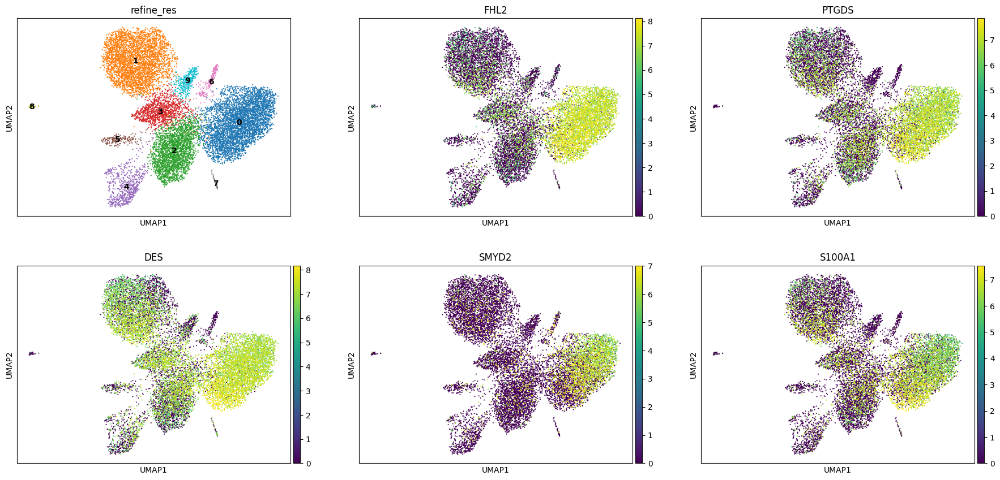

In [35]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [ ]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

In [36]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Cardiomyocyte'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Cardiomyocyte'

### 5.2. Cluster 1

In [37]:
cluster_id = '1'

In [38]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,Capillary EC,32
8,1,Venous EC,15
9,1,Arterial EC,9
10,1,Pericyte,6
11,1,Endocardial cell,5
12,1,B cell,4
13,1,Smooth muscle cell,3


In [39]:
top_ranked_genes[cluster_id]

0       VWF
1    PECAM1
2      TCIM
3      CD93
4     MCF2L
Name: 1, dtype: object

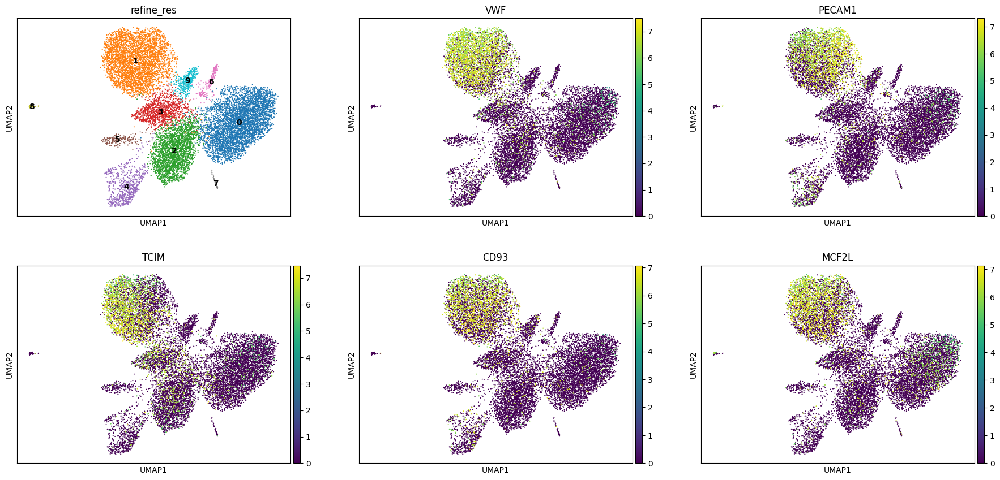

In [40]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 3709
Percentage of cells in cluster 1: 27.7


In [42]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.3. Cluster 2

In [43]:
cluster_id = '2'

In [44]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,SCN7A fibroblast,30
15,2,PCOLCE2 fibroblast,13
16,2,Monocyte,8
17,2,Pericyte,6
18,2,Neuron,5
19,2,POSTN fibroblast,4
20,2,Mesothelial cell,4


In [45]:
top_ranked_genes[cluster_id]

0        C7
1      FBN1
2     FBLN1
3    PDGFRA
4       PTN
Name: 2, dtype: object

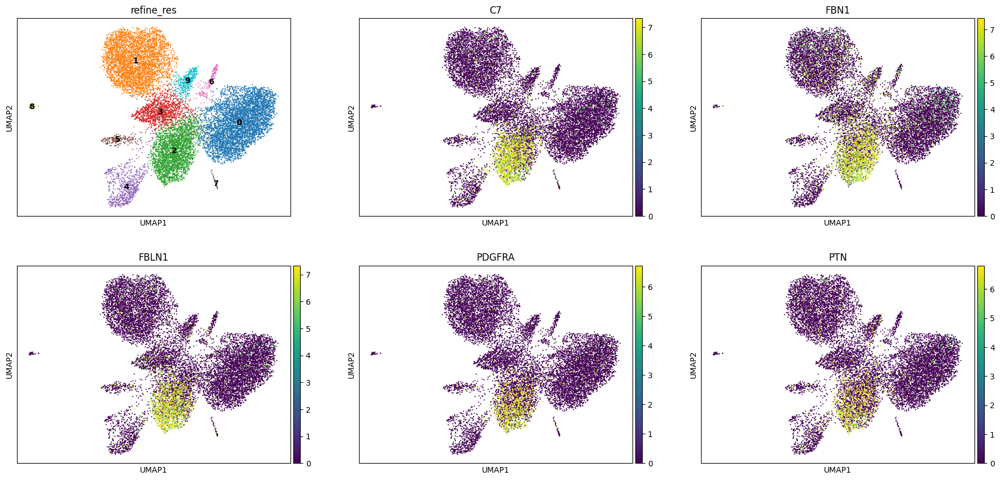

In [46]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [ ]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

In [48]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.4. Cluster 3

In [49]:
cluster_id = '3'

In [50]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,Pericyte,50
22,3,Smooth muscle cell,9
23,3,Neuron,4
24,3,TNC fibroblast,4
25,3,B cell,4
26,3,SCN7A fibroblast,3
27,3,Monocyte,3


In [51]:
top_ranked_genes[cluster_id]

0    PDGFRB
1    STEAP4
2     ACTA2
3     EDNRB
4      ASPN
Name: 3, dtype: object

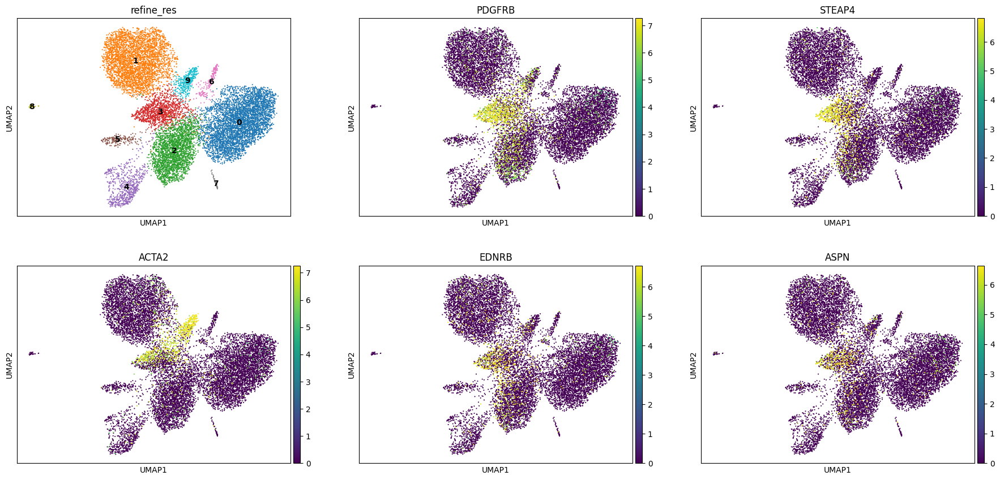

In [52]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [53]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 1155
Percentage of cells in cluster 3: 8.6


In [54]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Perivascular'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle_and_pericyte'

### 5.5. Cluster 4

In [55]:
cluster_id = '4'

In [56]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,LYVE1+ macrophage,57
29,4,Monocyte,21
30,4,SCN7A fibroblast,6
31,4,Venous EC,3
32,4,cDC,2
33,4,Pericyte,2
34,4,DIAPH3+ macrophage,2


In [57]:
top_ranked_genes[cluster_id]

0    MS4A6A
1     LYVE1
2    MS4A4A
3     MPEG1
4      MRC1
Name: 4, dtype: object

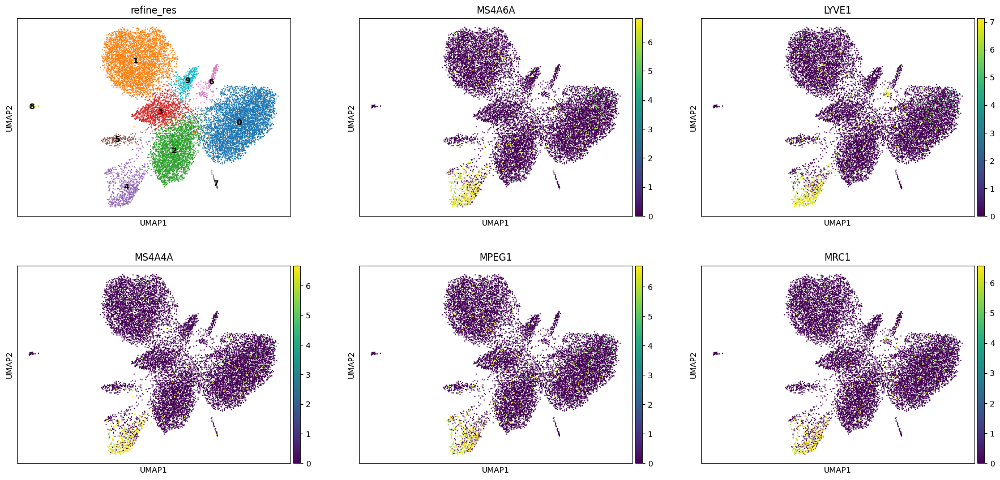

In [58]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 670
Percentage of cells in cluster 4: 5.0


In [60]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.6. Cluster 5

In [61]:
cluster_id = '5'

In [62]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,NK cell,26
36,5,T cell,17
37,5,LYVE1+ macrophage,12
38,5,Monocyte,7
39,5,DIAPH3+ macrophage,7
40,5,Pericyte,4
41,5,Mesothelial cell,4


In [63]:
top_ranked_genes[cluster_id]

0    PTPRC
1     CCL5
2     TRAC
3    CXCR4
4     CD8A
Name: 5, dtype: object

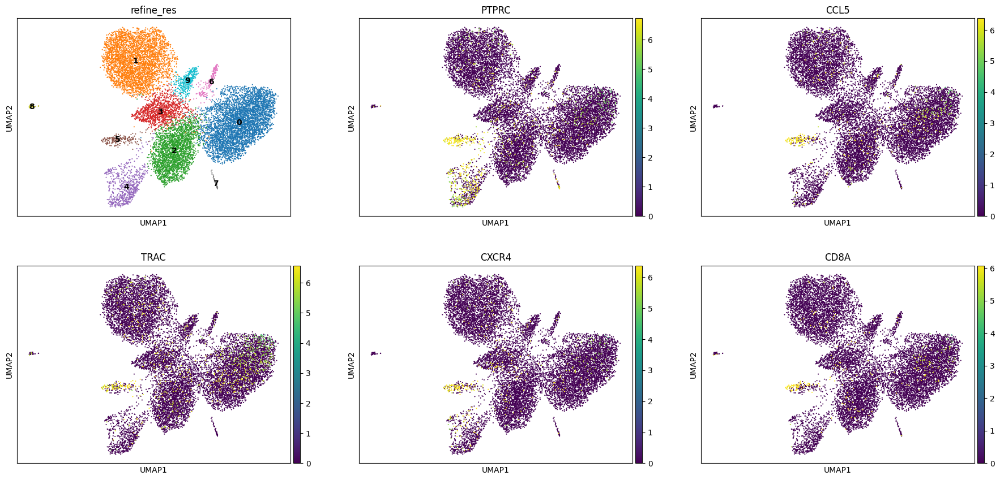

In [64]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 206
Percentage of cells in cluster 5: 1.5


In [66]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T/NK'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T/NK'

### 5.7. Cluster 6

In [67]:
cluster_id = '6'

In [68]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,Mesothelial cell,36
43,6,Monocyte,12
44,6,Venous EC,8
45,6,Lymphatic EC,7
46,6,LYVE1+ macrophage,6
47,6,SCN7A fibroblast,6
48,6,Pericyte,5


In [69]:
top_ranked_genes[cluster_id]

0      PRG4
1       CFB
2      PDPN
3     UPK3B
4    SEMA3C
Name: 6, dtype: object

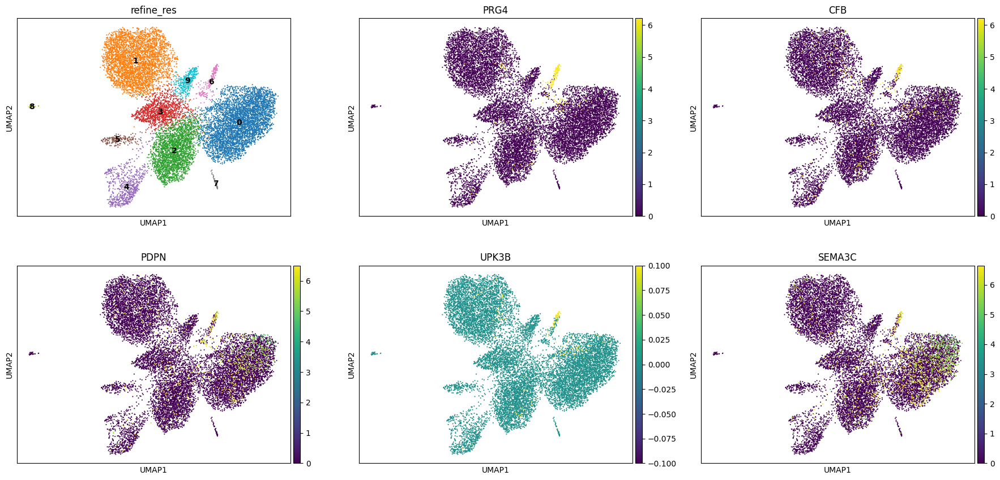

In [70]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 174
Percentage of cells in cluster 6: 1.3


In [72]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Valvular_interstitial_cell'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Valvular_interstitial_cell'

### 5.8. Cluster 7

In [73]:
cluster_id = '7'

In [74]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,Mast cell,32
50,7,Monocyte,10
51,7,NK cell,8
52,7,PCOLCE2 fibroblast,8
53,7,SCN7A fibroblast,8
54,7,Mesothelial cell,8
55,7,NR4A3 fibroblast,5


In [75]:
top_ranked_genes[cluster_id]

0       KIT
1    IL1RL1
2     MS4A2
3      CPA3
4       LIF
Name: 7, dtype: object

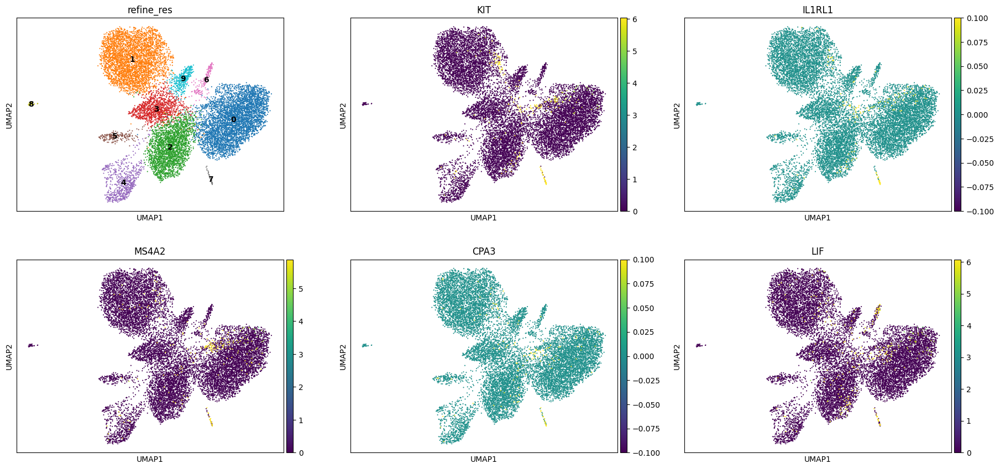

In [76]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 40
Percentage of cells in cluster 7: 0.3


In [78]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.9. Cluster 8

In [79]:
cluster_id = '8'

In [80]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
56,8,Pericyte,29
57,8,LYVE1+ macrophage,13
58,8,Capillary EC,10
59,8,DIAPH3+ macrophage,10
60,8,Atrial cardiomyocyte,6
61,8,PCOLCE2 fibroblast,6
62,8,Ventricular cardiomyocyte,3


In [81]:
top_ranked_genes[cluster_id]

0     GKN2
1     TFF2
2    CAPN8
3     MLPH
4    PPARG
Name: 8, dtype: object

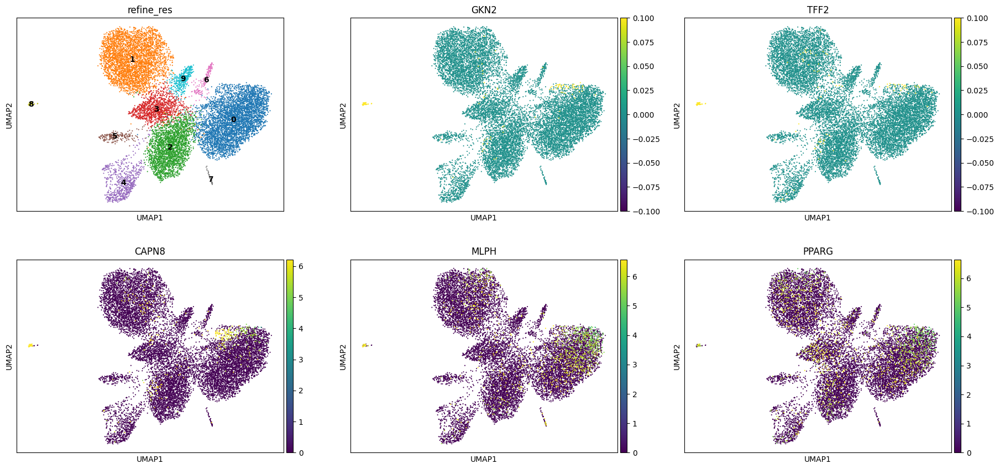

In [82]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 31
Percentage of cells in cluster 8: 0.2


In [84]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'ToRemove'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'ToRemove'

### 5.10. Cluster 9

In [95]:
cluster_id = '9'

In [86]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
63,9,Smooth muscle cell,56
64,9,Pericyte,13
65,9,Venous EC,3
66,9,SCN7A fibroblast,3
67,9,LYVE1+ macrophage,3
68,9,Monocyte,3
69,9,Neuron,2


In [87]:
top_ranked_genes[cluster_id]

0    MYH11
1    ACTA2
2     MYLK
3     NTN4
4     CNN1
Name: 9, dtype: object

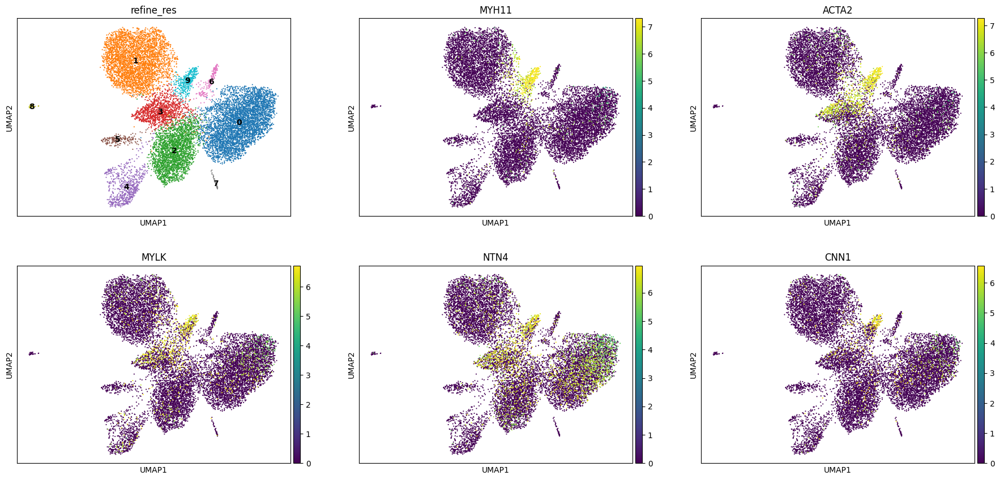

In [88]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [89]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 368
Percentage of cells in cluster 9: 2.7


In [96]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Perivascular'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

## 6. Cancer cells

In [93]:
# Not a cancerous patient
adata.obs['label3'] = 'normal_cell'

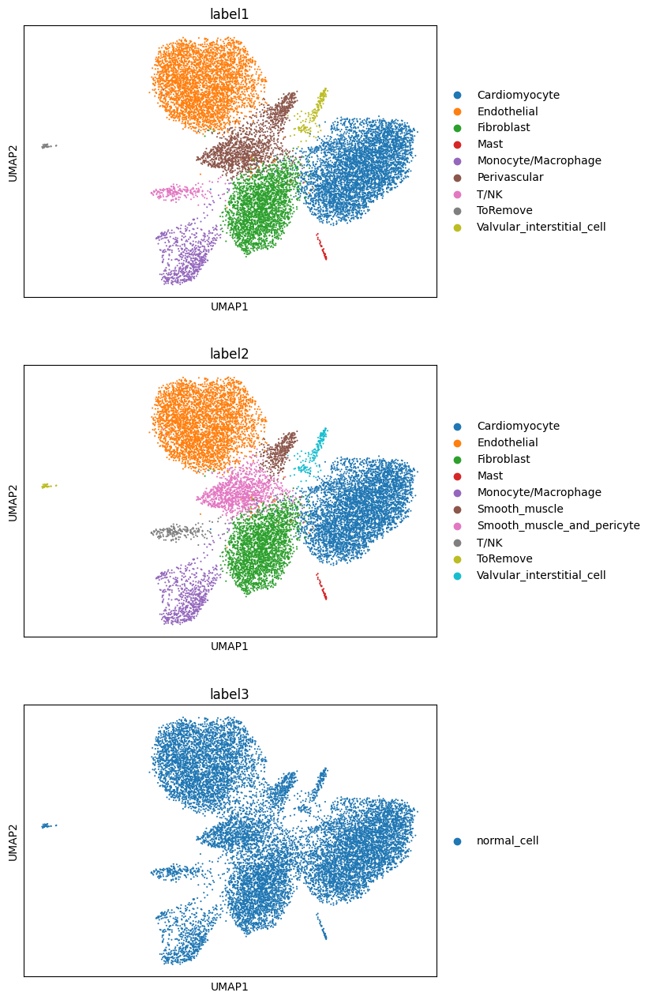

In [97]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [98]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,35.131678,Endocardial cell,22,0,0,7,0,Cardiomyocyte,Cardiomyocyte,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,38.134416,Neuron,20,0,0,0,0,Cardiomyocyte,Cardiomyocyte,normal_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,10.385908,Capillary EC,12,1,1,1,1,Endothelial,Endothelial,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,29.757835,Ventricular cardiomyocyte,25,0,0,0,0,Cardiomyocyte,Cardiomyocyte,normal_cell
aaaaaaah-1,nucleus_boundaries,morpho,aaaaaaah-1,10.295643,T cell,13,5,5,9,5,T/NK,T/NK,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaaggpg-1,nucleus_boundaries,morpho,aaaaggpg-1,15.172433,PCOLCE2 fibroblast,16,2,2,2,2,Fibroblast,Fibroblast,normal_cell
aaaaggpi-1,nucleus_boundaries,morpho,aaaaggpi-1,31.383749,Capillary EC,15,1,1,1,1,Endothelial,Endothelial,normal_cell
aaaaggpj-1,nucleus_boundaries,morpho,aaaaggpj-1,42.628748,NK cell,24,0,0,0,0,Cardiomyocyte,Cardiomyocyte,normal_cell
aaaaggpk-1,nucleus_boundaries,morpho,aaaaggpk-1,65.838842,Ventricular cardiomyocyte,49,0,0,0,0,Cardiomyocyte,Cardiomyocyte,normal_cell


In [99]:
adata.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")